# Backtesting trading strategies using `zipline` with LKTB `bundles`

한국거래소에 상장된 국고채 10년물 일별 가격DATA를 바탕으로 기초적인 몇가지 전략을 적용한 운용성과를 백테스트하는 예제입니다. 한도는 1,000억이며 전략에 따라 한도의 100%씩 거래하도록 합니다. 비교할 Benchmark 는 국고채 10년물 자신으로 합니다.

적용된 전략은 아래와 같습니다.
 1. Buy and Hold : 최초 거래일에 매수후 계속 보유
 2. Simple Moving Average : 현재가격이 20일 이동평균을 상향돌파하면 매수, 하향돌파하면 매도
 3. Moving Average Crossover : 단기(20일)이동평균선이 장기(100일)이동평균선을 상향돌파하면 매수, 하향돌파하면 매도
 4. MACD : MACD가 MACD signal을 상향돌파하면 매수, 하향돌파하면 매도
 5. RSI : RSI가 30% 하회시 과매도로 판단하여 매수, 70% 상회시 과매수로 판단하여 매도

---

zipline documentation : https://www.zipline.io/index.html

## Importing libraries

사용할 여러 라이브러리들을 불러옵니다.

In [2]:
%load_ext watermark
%load_ext zipline

%matplotlib inline
%config InlineBackend.figure_format = 'retina' # 그래프를 더 높은 해상도로 출력

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import zipline
from trading_calendars import get_calendar
# from yahoofinancials import YahooFinancials
import warnings

plt.style.use('seaborn')
plt.rcParams['figure.figsize'] = [16, 9]
plt.rcParams['figure.dpi'] = 200
warnings.simplefilter(action='ignore', category=FutureWarning)

import os
os.environ['ZIPLINE_ROOT'] = '/home/dt/.zipline'

The watermark extension is already loaded. To reload it, use:
  %reload_ext watermark
The zipline extension is already loaded. To reload it, use:
  %reload_ext zipline


---

## Backtesting Strategies

여러 가지 전략들을 백테스트합니다.

### 1. Buy And Hold

In [3]:
%%zipline --start 2018-1-2 --end 2019-12-30 --capital-base 100000 --bundle krx_futures -o buy_and_hold.pkl --trading-calendar XKRX

# imports
from zipline.api import order_percent, order, record, symbol, set_benchmark
from zipline.finance import commission

# parameters
SELECTED_STOCK = 'LKTB'
# n_stocks_to_buy = 10 # order_percent 로 변경하며 주석처리

def initialize(context):
    set_benchmark(symbol('LKTB'))
    context.asset = symbol(SELECTED_STOCK)
    context.has_ordered = False
    context.set_commission(commission.PerShare(cost=0.0, min_trade_cost=0))

def handle_data(context, data):
    
    # trading logic
    if not context.has_ordered:
        # placing order, negative number for sale/short
        order_percent(context.asset, 1)
        # setting up a flag for holding a position
        context.has_ordered = True
        
    # record price for further inspection
    record(price=data.current(context.asset, 'price'))

,algo_volatility,algorithm_period_return,alpha,benchmark_period_return,benchmark_volatility,beta,capital_used,ending_cash,ending_exposure,ending_value,...,short_exposure,short_value,shorts_count,sortino,starting_cash,starting_exposure,starting_value,trading_days,transactions,treasury_period_return
2018-01-02 06:30:00+00:00,NaN,0.000000,NaN,-0.002474,NaN,NaN,0.00000,100000.00000,0.000,0.000,...,0.0,0.0,0,NaN,100000.00000,0.000,0.000,1,[],0.0
2018-01-03 06:30:00+00:00,0.005603,-0.000499,-0.179901,-0.003216,0.019419,-0.288555,-99888.53931,111.46069,99838.620,99838.620,...,0.0,0.0,0,-11.224972,100000.00000,0.000,0.000,2,"[{'sid': Equity(5 [LKTB]), 'commission': None,...",0.0
2018-01-04 06:30:00+00:00,0.018590,-0.002729,-0.126746,-0.005443,0.014877,0.224074,0.00000,111.46069,99615.600,99615.600,...,0.0,0.0,0,-10.945031,111.46069,99838.620,99838.620,3,[],0.0
2018-01-05 06:30:00+00:00,0.022854,-0.001490,0.067274,-0.004206,0.027164,0.607390,0.00000,111.46069,99739.500,99739.500,...,0.0,0.0,0,-5.165842,111.46069,99615.600,99615.600,4,[],0.0
2018-01-08 06:30:00+00:00,0.023478,-0.003638,0.043472,-0.006350,0.024790,0.707632,0.00000,111.46069,99524.740,99524.740,...,0.0,0.0,0,-8.229689,111.46069,99739.500,99739.500,5,[],0.0
2018-01-09 06:30:00+00:00,0.024704,-0.006364,0.041972,-0.009071,0.024124,0.810319,0.00000,111.46069,99252.160,99252.160,...,0.0,0.0,0,-9.921557,111.46069,99524.740,99524.740,6,[],0.0
2018-01-10 06:30:00+00:00,0.034077,-0.011650,0.082602,-0.014349,0.031740,0.969714,0.00000,111.46069,98723.520,98723.520,...,0.0,0.0,0,-10.386278,111.46069,99252.160,99252.160,7,[],0.0
2018-01-11 06:30:00+00:00,0.042905,-0.008181,0.068122,-0.010886,0.042925,0.948238,0.00000,111.46069,99070.440,99070.440,...,0.0,0.0,0,-6.799491,111.46069,98723.520,98723.520,8,[],0.0
2018-01-12 06:30:00+00:00,0.040523,-0.010246,0.059294,-0.012947,0.040333,0.952899,0.00000,111.46069,98863.940,98863.940,...,0.0,0.0,0,-7.684694,111.46069,99070.440,99070.440,9,[],0.0
2018-01-15 06:30:00+00:00,0.040677,-0.014128,0.055744,-0.016823,0.040017,0.969145,0.00000,111.46069,98475.720,98475.720,...,0.0,0.0,0,-8.810341,111.46069,98863.940,98863.940,10,[],0.0


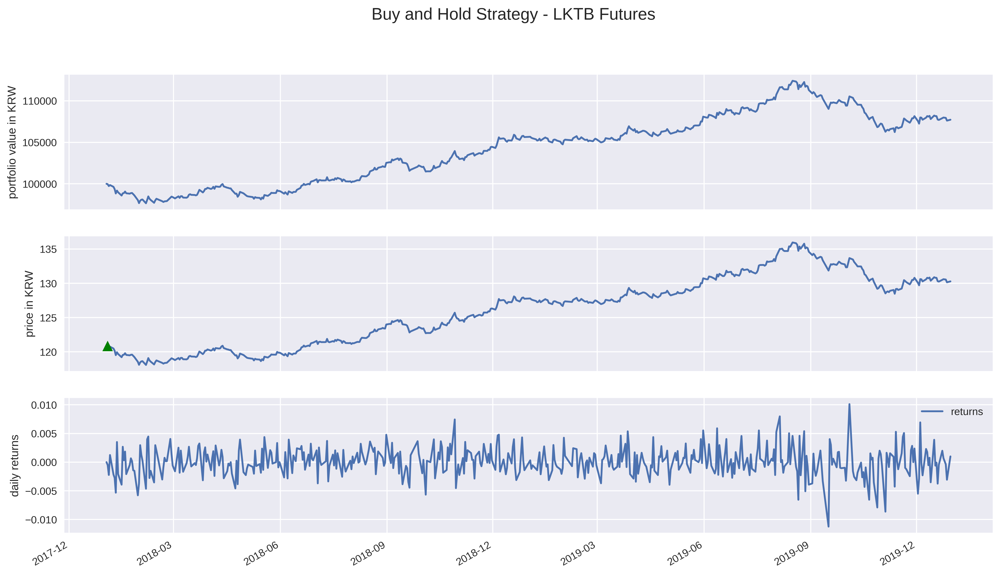

Final portfolio value (including cash): 107722.74KRW


In [4]:
# read the performance summary dataframe
buy_and_hold_results = pd.read_pickle('buy_and_hold.pkl')
buy_and_hold_results.to_csv("buy_and_hold.csv")

# import helper functions 
import qf_helper_functions as qf

qf.visualize_results(buy_and_hold_results, 'Buy and Hold Strategy - LKTB Futures', 'KRW')
buy_and_hold_perf = qf.get_performance_summary(buy_and_hold_results.returns)

Start date,2018-01-02
End date,2019-12-30
Total months,23
,Backtest
Annual return,3.9%
Cumulative returns,7.7%
Annual volatility,3.9%
Sharpe ratio,1.00
Calmar ratio,0.71
Stability,0.88
Max drawdown,-5.5%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,5.50,2019-08-16,2019-11-12,NaT,NaN
1,2.35,2018-01-02,2018-02-05,2018-06-27,127
2,1.54,2018-09-10,2018-10-04,2018-10-26,35
3,1.14,2019-03-28,2019-04-17,2019-05-23,41
4,1.09,2018-12-19,2019-01-30,2019-03-25,69


Stress Events,mean,min,max
New Normal,0.02%,-1.12%,1.01%


Top 10 long positions of all time,max
sid,
LKTB,99.90%


Top 10 short positions of all time,max
sid,


Top 10 positions of all time,max
sid,
LKTB,99.90%


/opt/conda/envs/backtest/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


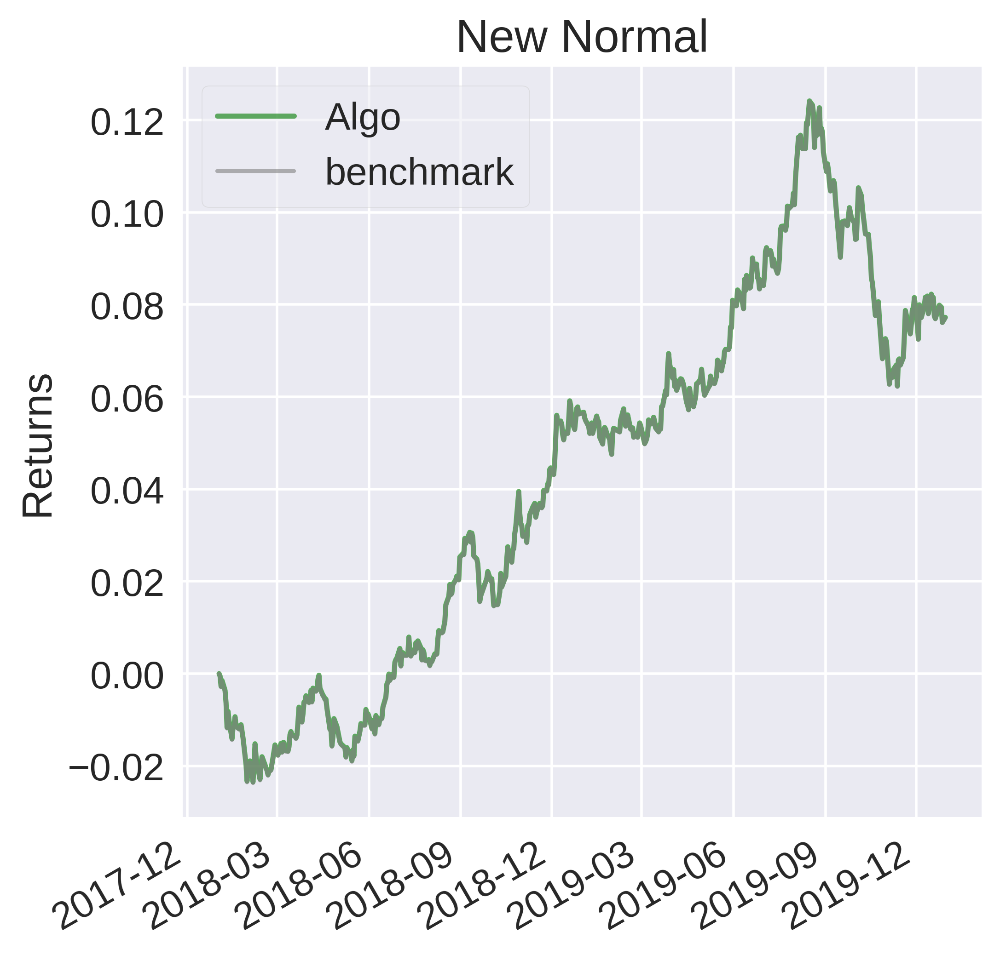

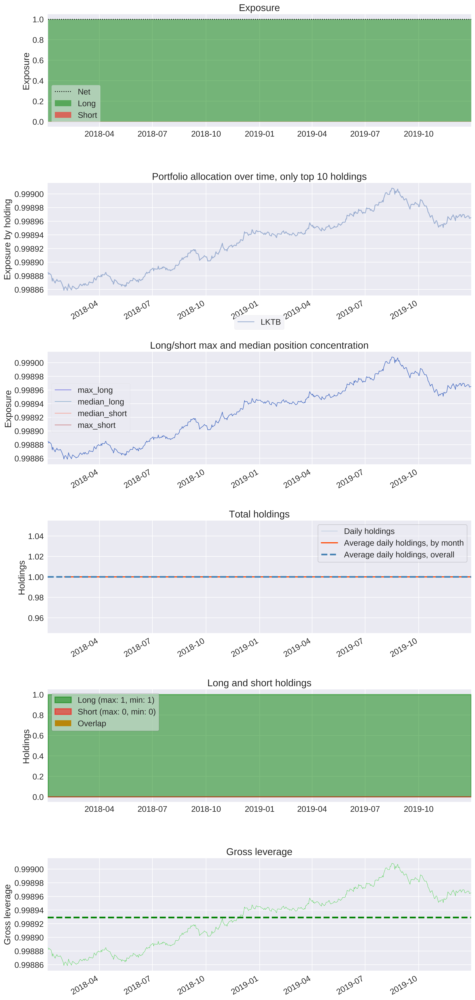

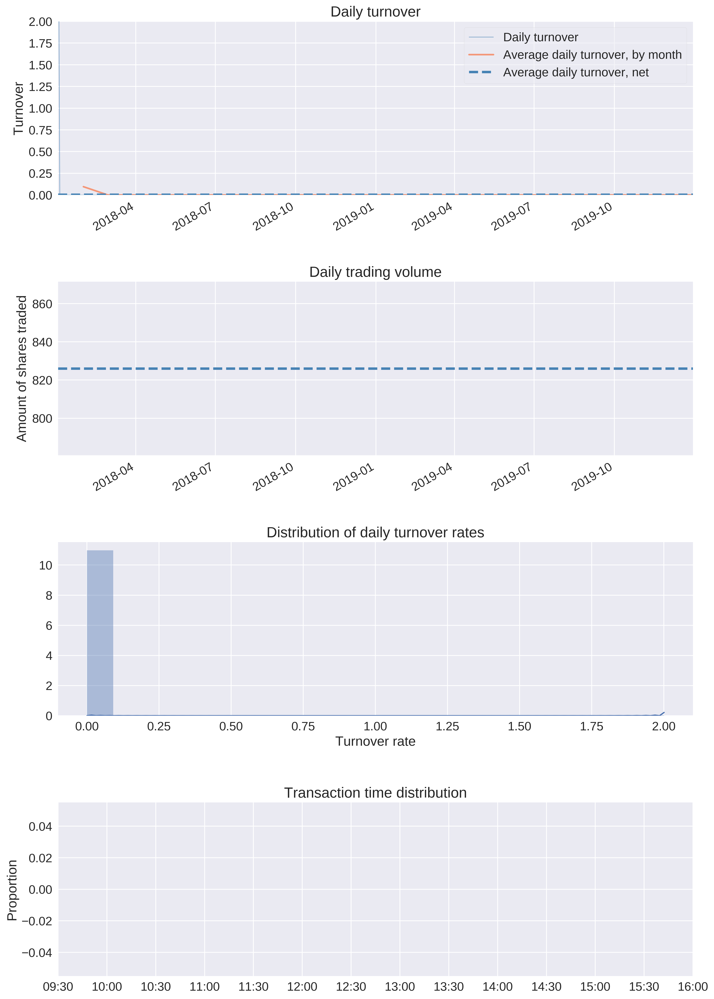

In [5]:
import pyfolio as pf
returns, positions, transactions = pf.utils.extract_rets_pos_txn_from_zipline(buy_and_hold_results)
benchmark_period_return = buy_and_hold_results['benchmark_period_return']
# Convert benchmark returns to daily returns
#daily_returns = (1 + benchmark_period_return) / (1 + benchmark_period_return.shift()) - 1
daily_benchmark_returns = np.exp(np.log(benchmark_period_return + 1.0).diff()) - 1
sheets = pf.create_full_tear_sheet(returns, positions=positions, transactions=transactions, benchmark_rets=daily_benchmark_returns)

### 2. Simple Moving Average

In [6]:
%%zipline --start 2018-1-2 --end 2019-12-30 --capital-base 100000 --bundle krx_futures -o simple_moving_average.pkl --trading-calendar XKRX

# imports 
from zipline.api import order_percent, order, record, symbol, set_benchmark, set_slippage, order_target
from zipline.finance import commission, slippage

# parameters 
MA_PERIODS = 20
SELECTED_STOCK = 'LKTB'

def initialize(context):
    
    set_benchmark(symbol('LKTB'))
    context.asset = symbol(SELECTED_STOCK)
    context.has_position = False
    context.set_commission(commission.PerShare(cost=0.0, min_trade_cost=0))
    context.set_slippage(slippage.FixedSlippage(spread=0))

def handle_data(context, data):
    
    price_history = data.history(context.asset, fields="price", bar_count=MA_PERIODS, frequency="1d")
    ma = price_history.mean()
    
    # cross up
    if (price_history[-2] < ma) & (price_history[-1] > ma) & (not context.has_position):
        order_percent(context.asset, 1.0)
        context.has_position = True
    # cross down
    elif (price_history[-2] > ma) & (price_history[-1] < ma) & (context.has_position):
        order_target(context.asset, 0)
        context.has_position = False

    record(price=data.current(context.asset, 'price'),
           moving_average=ma)

/opt/conda/envs/backtest/lib/python3.5/site-packages/empyrical/stats.py:790: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/opt/conda/envs/backtest/lib/python3.5/site-packages/empyrical/stats.py:704: RuntimeWarning: invalid value encountered in true_divide
  out=out,


,algo_volatility,algorithm_period_return,alpha,benchmark_period_return,benchmark_volatility,beta,capital_used,ending_cash,ending_exposure,ending_value,...,short_exposure,short_value,shorts_count,sortino,starting_cash,starting_exposure,starting_value,trading_days,transactions,treasury_period_return
2018-01-02 06:30:00+00:00,NaN,0.000000,NaN,-0.002474,NaN,NaN,0.00,100000.000,0.000,0.000,...,0.0,0.0,0,NaN,100000.000,0.000,0.000,1,[],0.0
2018-01-03 06:30:00+00:00,0.000000,0.000000,0.000000,-0.003216,0.019419,0.000000,0.00,100000.000,0.000,0.000,...,0.0,0.0,0,NaN,100000.000,0.000,0.000,2,[],0.0
2018-01-04 06:30:00+00:00,0.000000,0.000000,0.000000,-0.005443,0.014877,0.000000,0.00,100000.000,0.000,0.000,...,0.0,0.0,0,NaN,100000.000,0.000,0.000,3,[],0.0
2018-01-05 06:30:00+00:00,0.000000,0.000000,0.000000,-0.004206,0.027164,0.000000,0.00,100000.000,0.000,0.000,...,0.0,0.0,0,NaN,100000.000,0.000,0.000,4,[],0.0
2018-01-08 06:30:00+00:00,0.000000,0.000000,0.000000,-0.006350,0.024790,0.000000,0.00,100000.000,0.000,0.000,...,0.0,0.0,0,NaN,100000.000,0.000,0.000,5,[],0.0
2018-01-09 06:30:00+00:00,0.000000,0.000000,0.000000,-0.009071,0.024124,0.000000,0.00,100000.000,0.000,0.000,...,0.0,0.0,0,NaN,100000.000,0.000,0.000,6,[],0.0
2018-01-10 06:30:00+00:00,0.000000,0.000000,0.000000,-0.014349,0.031740,0.000000,0.00,100000.000,0.000,0.000,...,0.0,0.0,0,NaN,100000.000,0.000,0.000,7,[],0.0
2018-01-11 06:30:00+00:00,0.000000,0.000000,0.000000,-0.010886,0.042925,0.000000,0.00,100000.000,0.000,0.000,...,0.0,0.0,0,NaN,100000.000,0.000,0.000,8,[],0.0
2018-01-12 06:30:00+00:00,0.000000,0.000000,0.000000,-0.012947,0.040333,0.000000,0.00,100000.000,0.000,0.000,...,0.0,0.0,0,NaN,100000.000,0.000,0.000,9,[],0.0
2018-01-15 06:30:00+00:00,0.000000,0.000000,0.000000,-0.016823,0.040017,0.000000,0.00,100000.000,0.000,0.000,...,0.0,0.0,0,NaN,100000.000,0.000,0.000,10,[],0.0


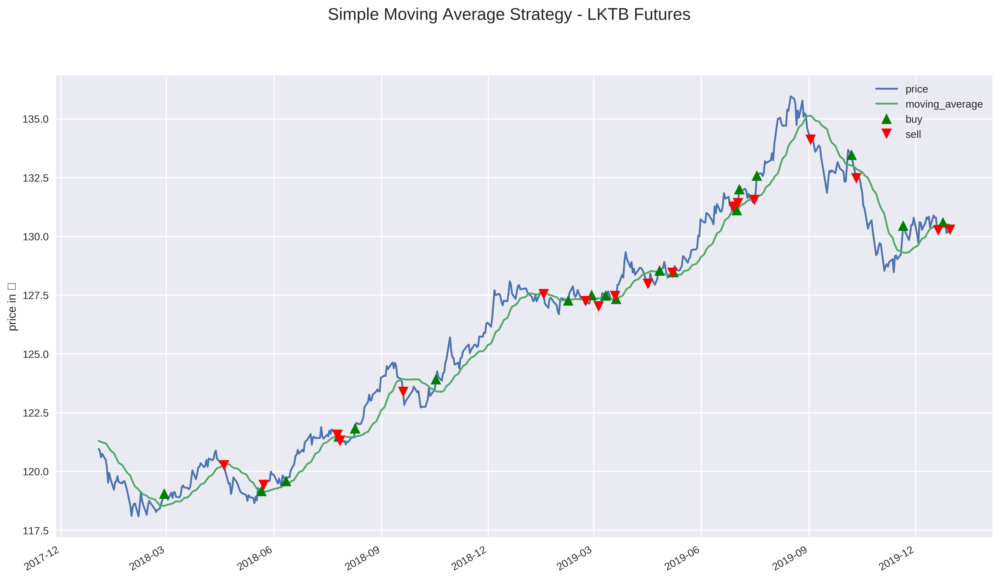

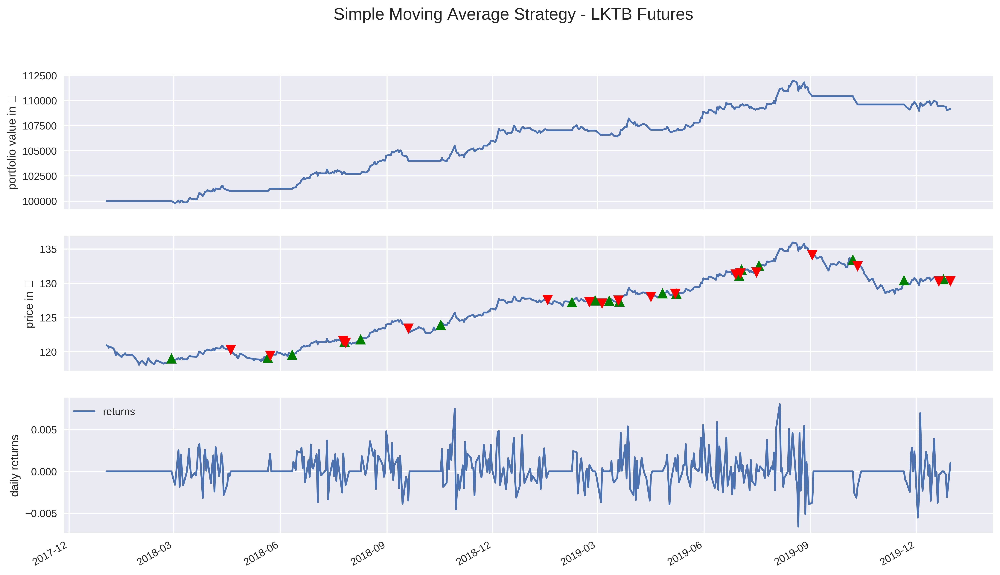

Final portfolio value (including cash): 109171.63￦


In [7]:
sma_results = pd.read_pickle('simple_moving_average.pkl')
fig, ax = plt.subplots()

# asset
sma_results[['price', 'moving_average']].plot(ax=ax)
ax.set_ylabel('price in ￦')

# mark transactions
perf_trans = sma_results.loc[[t != [] for t in sma_results.transactions]]
buys = perf_trans.loc[[t[0]['amount'] > 0 for t in perf_trans.transactions]]
sells = perf_trans.loc[[t[0]['amount'] < 0 for t in perf_trans.transactions]]
ax.plot(buys.index, sma_results.price.loc[buys.index], '^', markersize=10, color='g', label='buy')
ax.plot(sells.index, sma_results.price.loc[sells.index], 'v', markersize=10, color='r', label='sell')
ax.legend()

fig.suptitle('Simple Moving Average Strategy - LKTB Futures', fontsize=16)
plt.legend()
plt.show()

# import helper functions 
import qf_helper_functions as qf

qf.visualize_results(sma_results, 'Simple Moving Average Strategy - LKTB Futures', '￦')
sma_perf = qf.get_performance_summary(sma_results.returns)

Start date,2018-01-02
End date,2019-12-30
Total months,23
,Backtest
Annual return,4.6%
Cumulative returns,9.2%
Annual volatility,2.9%
Sharpe ratio,1.59
Calmar ratio,1.73
Stability,0.94
Max drawdown,-2.7%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,2.67,2019-08-16,2019-12-03,NaT,NaN
1,1.28,2019-03-28,2019-05-03,2019-05-29,45
2,1.07,2018-09-10,2018-10-22,2018-10-29,36
3,1.06,2018-10-29,2018-11-06,2018-11-23,20
4,1.05,2019-02-11,2019-03-18,2019-03-27,33


Stress Events,mean,min,max
New Normal,0.02%,-0.66%,0.80%


Top 10 long positions of all time,max
sid,
LKTB,100.55%


Top 10 short positions of all time,max
sid,


Top 10 positions of all time,max
sid,
LKTB,100.55%


/opt/conda/envs/backtest/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


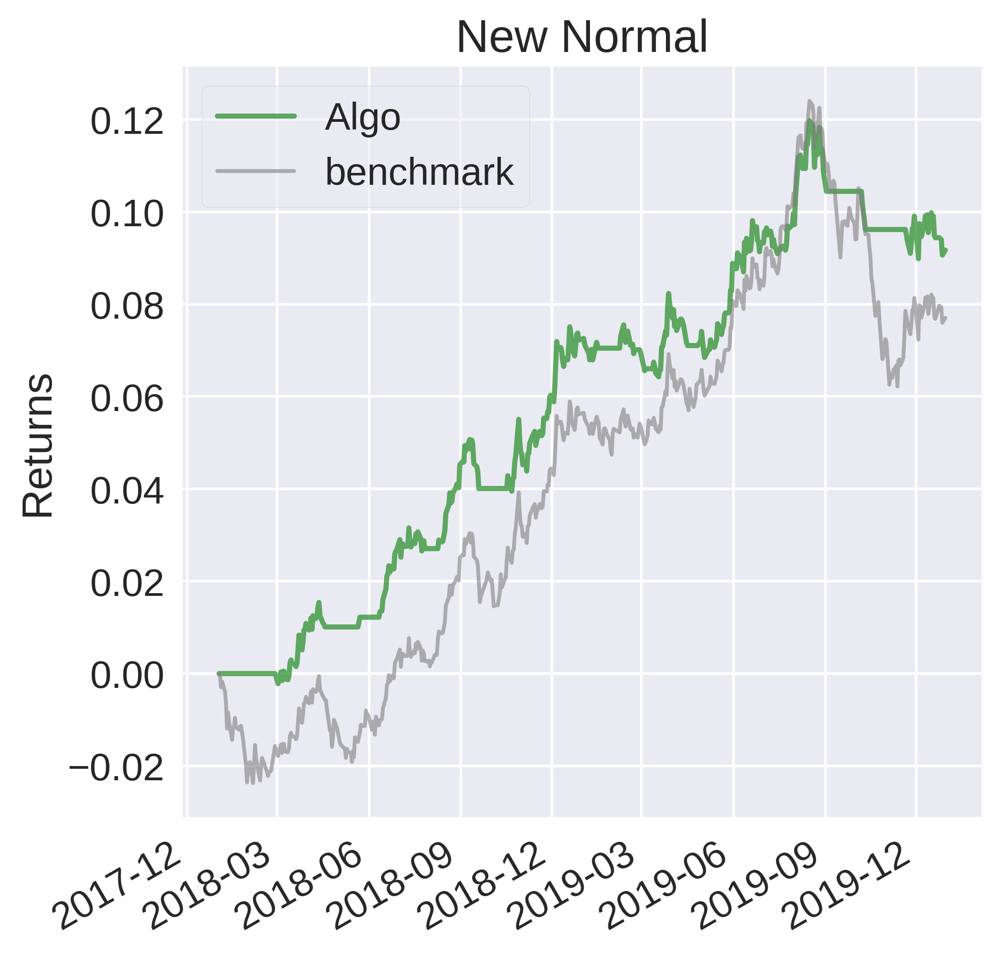

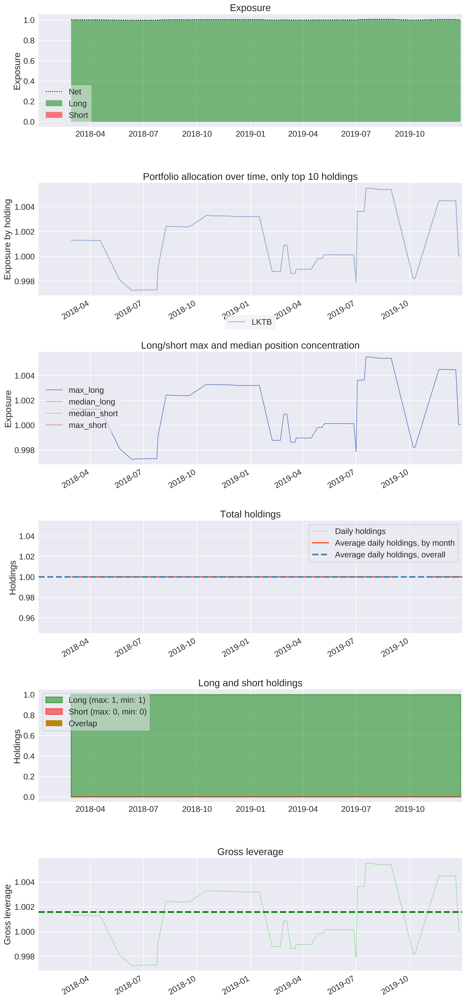

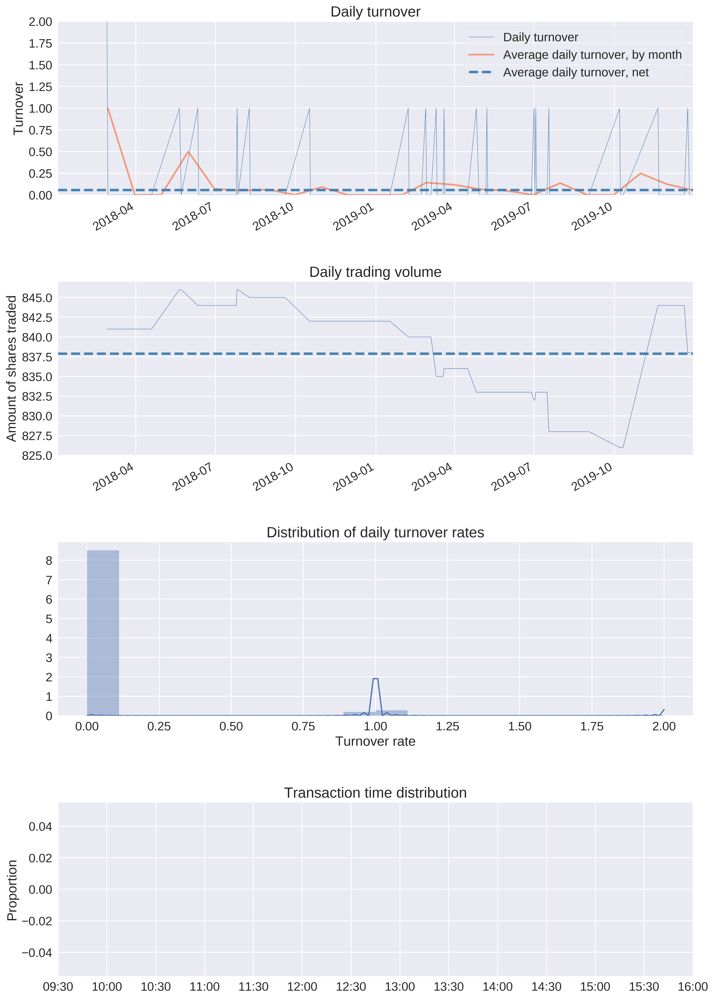

In [8]:
import pyfolio as pf
returns, positions, transactions = pf.utils.extract_rets_pos_txn_from_zipline(sma_results)
benchmark_period_return = sma_results['benchmark_period_return']
# Convert benchmark returns to daily returns
#daily_returns = (1 + benchmark_period_return) / (1 + benchmark_period_return.shift()) - 1
daily_benchmark_returns = np.exp(np.log(benchmark_period_return + 1.0).diff()) - 1
sheets = pf.create_full_tear_sheet(returns, positions=positions, transactions=transactions, benchmark_rets=daily_benchmark_returns)

### 3. Moving Average Crossover

In [9]:
%%zipline --start 2018-1-2 --end 2019-12-30 --capital-base 100000 --bundle krx_futures -o moving_average_crossover.pkl --trading-calendar XKRX

# imports 
from zipline.api import order_percent, order, record, symbol, set_benchmark, set_slippage, order_target
from zipline.finance import commission, slippage

# parameters 
SELECTED_STOCK = 'LKTB'
SLOW_MA_PERIODS = 100
FAST_MA_PERIODS = 20

def initialize(context):
    
    set_benchmark(symbol('LKTB'))
    context.asset = symbol(SELECTED_STOCK)
    context.has_position = False
    context.set_commission(commission.PerShare(cost=0.0, min_trade_cost=0))
    context.set_slippage(slippage.FixedSlippage(spread=0))
    
def handle_data(context, data):

    fast_ma = data.history(context.asset, 'price', bar_count=FAST_MA_PERIODS, frequency="1d").mean()
    slow_ma = data.history(context.asset, 'price', bar_count=SLOW_MA_PERIODS, frequency="1d").mean()

    # Trading logic
    if (fast_ma > slow_ma) & (not context.has_position):
        order_percent(context.asset, 1.0)
        context.has_position = True
    elif (fast_ma < slow_ma) & (context.has_position):
        order_target(context.asset, 0)
        context.has_position = False

    record(price=data.current(context.asset, 'price'),
           fast_ma=fast_ma,
           slow_ma=slow_ma)

/opt/conda/envs/backtest/lib/python3.5/site-packages/empyrical/stats.py:704: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/opt/conda/envs/backtest/lib/python3.5/site-packages/empyrical/stats.py:790: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/opt/conda/envs/backtest/lib/python3.5/site-packages/empyrical/stats.py:790: RuntimeWarning: divide by zero encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)


,algo_volatility,algorithm_period_return,alpha,benchmark_period_return,benchmark_volatility,beta,capital_used,ending_cash,ending_exposure,ending_value,...,short_value,shorts_count,slow_ma,sortino,starting_cash,starting_exposure,starting_value,trading_days,transactions,treasury_period_return
2018-01-02 06:30:00+00:00,NaN,0.000000,NaN,-0.002474,NaN,NaN,0.0,100000.00,0.0,0.0,...,0.0,0,121.77320,NaN,100000.00,0.0,0.0,1,[],0.0
2018-01-03 06:30:00+00:00,0.000000,0.000000,0.000000,-0.003216,0.019419,0.000000,0.0,100000.00,0.0,0.0,...,0.0,0,121.75020,NaN,100000.00,0.0,0.0,2,[],0.0
2018-01-04 06:30:00+00:00,0.000000,0.000000,0.000000,-0.005443,0.014877,0.000000,0.0,100000.00,0.0,0.0,...,0.0,0,121.72500,NaN,100000.00,0.0,0.0,3,[],0.0
2018-01-05 06:30:00+00:00,0.000000,0.000000,0.000000,-0.004206,0.027164,0.000000,0.0,100000.00,0.0,0.0,...,0.0,0,121.70120,NaN,100000.00,0.0,0.0,4,[],0.0
2018-01-08 06:30:00+00:00,0.000000,0.000000,0.000000,-0.006350,0.024790,0.000000,0.0,100000.00,0.0,0.0,...,0.0,0,121.67910,NaN,100000.00,0.0,0.0,5,[],0.0
2018-01-09 06:30:00+00:00,0.000000,0.000000,0.000000,-0.009071,0.024124,0.000000,0.0,100000.00,0.0,0.0,...,0.0,0,121.65540,NaN,100000.00,0.0,0.0,6,[],0.0
2018-01-10 06:30:00+00:00,0.000000,0.000000,0.000000,-0.014349,0.031740,0.000000,0.0,100000.00,0.0,0.0,...,0.0,0,121.62750,NaN,100000.00,0.0,0.0,7,[],0.0
2018-01-11 06:30:00+00:00,0.000000,0.000000,0.000000,-0.010886,0.042925,0.000000,0.0,100000.00,0.0,0.0,...,0.0,0,121.60210,NaN,100000.00,0.0,0.0,8,[],0.0
2018-01-12 06:30:00+00:00,0.000000,0.000000,0.000000,-0.012947,0.040333,0.000000,0.0,100000.00,0.0,0.0,...,0.0,0,121.57210,NaN,100000.00,0.0,0.0,9,[],0.0
2018-01-15 06:30:00+00:00,0.000000,0.000000,0.000000,-0.016823,0.040017,0.000000,0.0,100000.00,0.0,0.0,...,0.0,0,121.53780,NaN,100000.00,0.0,0.0,10,[],0.0


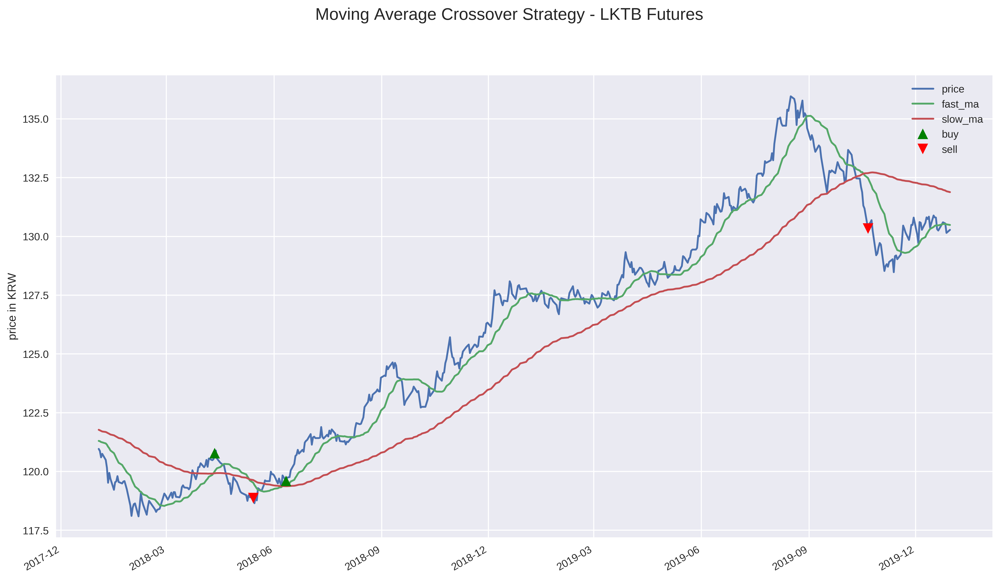

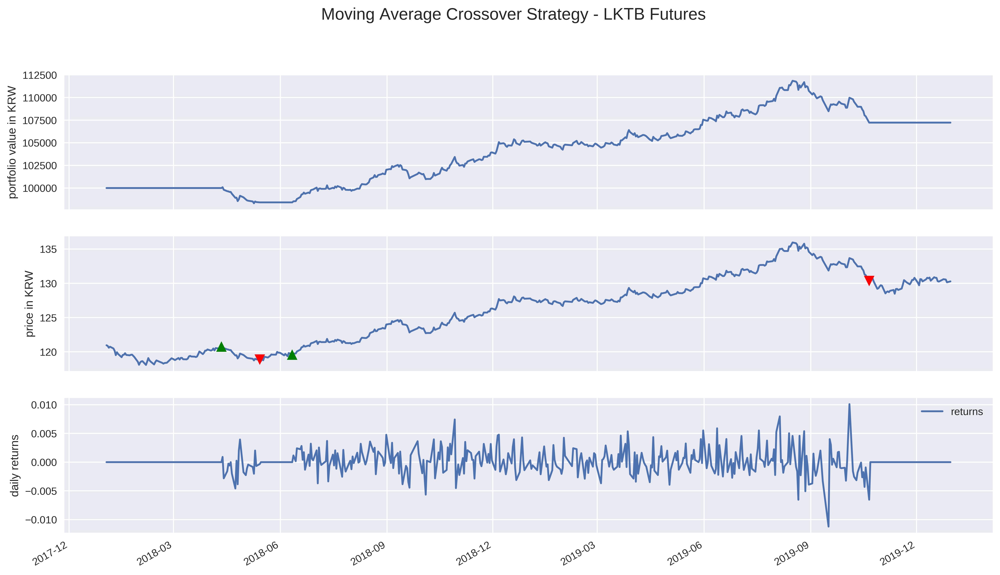

Final portfolio value (including cash): 107225.94KRW


In [10]:
mac_results = pd.read_pickle('moving_average_crossover.pkl')
fig, ax = plt.subplots()

# asset
mac_results[['price', 'fast_ma', 'slow_ma']].plot(ax=ax)
ax.set_ylabel('price in KRW')

# mark transactions
perf_trans = mac_results.loc[[t != [] for t in mac_results.transactions]]
buys = perf_trans.loc[[t[0]['amount'] > 0 for t in perf_trans.transactions]]
sells = perf_trans.loc[[t[0]['amount'] < 0 for t in perf_trans.transactions]]
ax.plot(buys.index, mac_results.price.loc[buys.index], '^', markersize=10, color='g', label='buy')
ax.plot(sells.index, mac_results.price.loc[sells.index], 'v', markersize=10, color='r', label='sell')
ax.legend()

fig.suptitle('Moving Average Crossover Strategy - LKTB Futures', fontsize=16)
plt.legend()
plt.show()

# import helper functions 
import qf_helper_functions as qf

qf.visualize_results(mac_results, 'Moving Average Crossover Strategy - LKTB Futures', 'KRW')
mac_perf = qf.get_performance_summary(mac_results.returns)

Start date,2018-01-02
End date,2019-12-30
Total months,23
,Backtest
Annual return,3.7%
Cumulative returns,7.2%
Annual volatility,3.3%
Sharpe ratio,1.12
Calmar ratio,0.88
Stability,0.86
Max drawdown,-4.1%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,4.13,2019-08-16,2019-10-21,NaT,NaN
1,1.77,2018-04-12,2018-05-09,2018-07-11,65
2,1.54,2018-09-10,2018-10-04,2018-10-26,35
3,1.13,2019-03-28,2019-04-17,2019-05-23,41
4,1.09,2018-12-19,2019-01-30,2019-03-25,69


Stress Events,mean,min,max
New Normal,0.01%,-1.12%,1.01%


Top 10 long positions of all time,max
sid,
LKTB,100.13%


Top 10 short positions of all time,max
sid,


Top 10 positions of all time,max
sid,
LKTB,100.13%


/opt/conda/envs/backtest/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


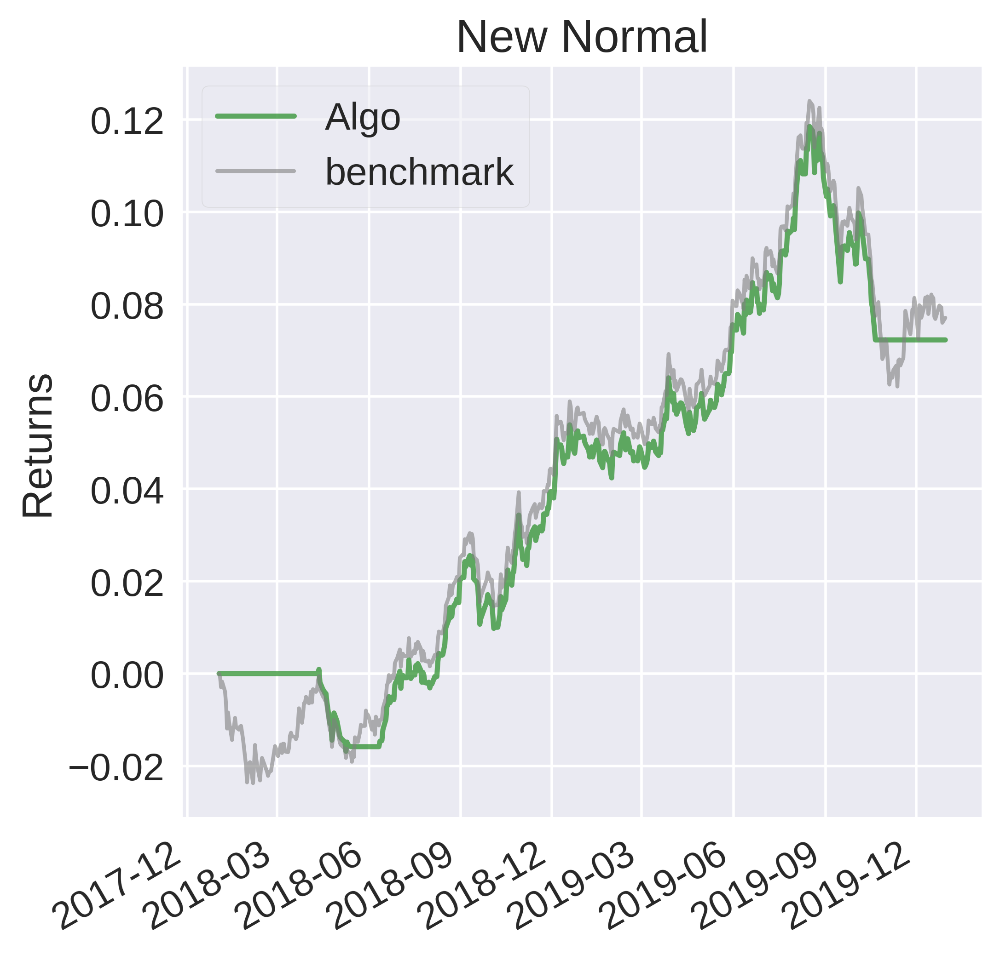

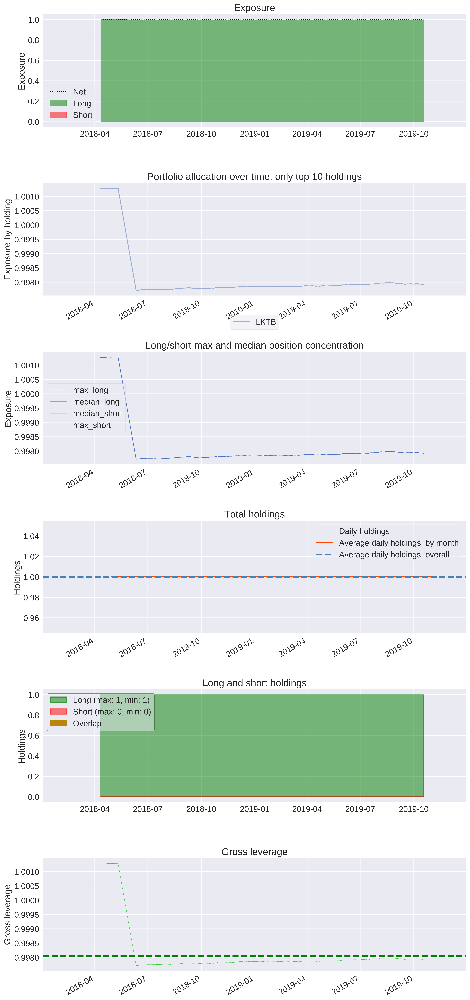

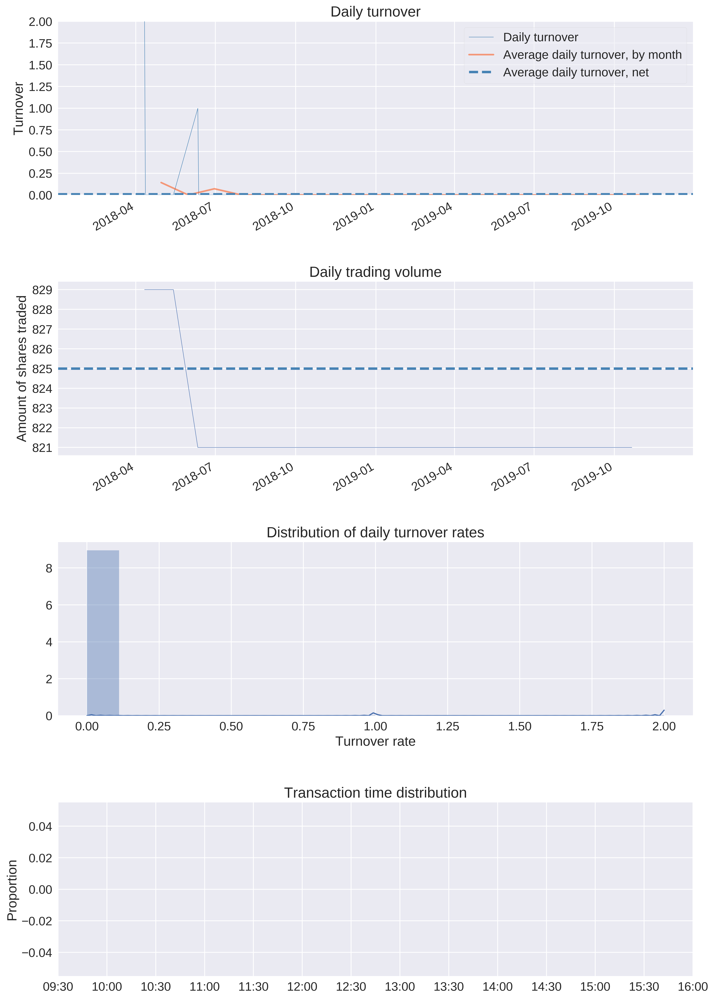

In [11]:
import pyfolio as pf
returns, positions, transactions = pf.utils.extract_rets_pos_txn_from_zipline(mac_results)
benchmark_period_return = mac_results['benchmark_period_return']
# Convert benchmark returns to daily returns
#daily_returns = (1 + benchmark_period_return) / (1 + benchmark_period_return.shift()) - 1
daily_benchmark_returns = np.exp(np.log(benchmark_period_return + 1.0).diff()) - 1
sheets = pf.create_full_tear_sheet(returns, positions=positions, transactions=transactions, benchmark_rets=daily_benchmark_returns)

### 4. MACD

In [12]:
%%zipline --start 2018-1-2 --end 2019-12-30 --capital-base 100000 --bundle krx_futures -o macd.pkl --trading-calendar XKRX

# imports ----
from zipline.api import order_percent, order, record, symbol, set_benchmark, set_slippage, order_target
from zipline.finance import commission, slippage
import matplotlib.pyplot as plt
import talib as ta

# parameters ----
SELECTED_STOCK = 'LKTB'

 #initialize the strategy 
def initialize(context):

    set_benchmark(symbol('LKTB'))
    context.asset = symbol(SELECTED_STOCK)
    context.has_position = False
    context.set_commission(commission.PerShare(cost=0.0, min_trade_cost=0))
    context.set_slippage(slippage.FixedSlippage(spread=0))
    
def handle_data(context, data):
    
    price_history = data.history(context.asset, fields="price", bar_count=34, frequency="1d")
    macd, macdsignal, macdhist = ta.MACD(price_history, 12, 26, 9) 
    
    if (macdsignal[-1] < macd[-1]) and (not context.has_position):
        order_percent(context.asset, 1.0)
        context.has_position = True
        
    if (macdsignal[-1] > macd[-1]) and (context.has_position):
        order_target(context.asset, 0)
        context.has_position = False
        
    record(macd =  macd[-1], macdsignal = macdsignal[-1], macdhist = macdhist[-1], price=price_history[-1]) 

/opt/conda/envs/backtest/lib/python3.5/site-packages/empyrical/stats.py:704: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/opt/conda/envs/backtest/lib/python3.5/site-packages/empyrical/stats.py:790: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)


,algo_volatility,algorithm_period_return,alpha,benchmark_period_return,benchmark_volatility,beta,capital_used,ending_cash,ending_exposure,ending_value,...,short_exposure,short_value,shorts_count,sortino,starting_cash,starting_exposure,starting_value,trading_days,transactions,treasury_period_return
2018-01-02 06:30:00+00:00,NaN,0.000000,NaN,-0.002474,NaN,NaN,0.00,100000.00,0.000,0.000,...,0.0,0.0,0,NaN,100000.00,0.000,0.000,1,[],0.0
2018-01-03 06:30:00+00:00,0.000000,0.000000,0.000000,-0.003216,0.019419,0.000000,0.00,100000.00,0.000,0.000,...,0.0,0.0,0,NaN,100000.00,0.000,0.000,2,[],0.0
2018-01-04 06:30:00+00:00,0.000000,0.000000,0.000000,-0.005443,0.014877,0.000000,0.00,100000.00,0.000,0.000,...,0.0,0.0,0,NaN,100000.00,0.000,0.000,3,[],0.0
2018-01-05 06:30:00+00:00,0.000000,0.000000,0.000000,-0.004206,0.027164,0.000000,0.00,100000.00,0.000,0.000,...,0.0,0.0,0,NaN,100000.00,0.000,0.000,4,[],0.0
2018-01-08 06:30:00+00:00,0.000000,0.000000,0.000000,-0.006350,0.024790,0.000000,0.00,100000.00,0.000,0.000,...,0.0,0.0,0,NaN,100000.00,0.000,0.000,5,[],0.0
2018-01-09 06:30:00+00:00,0.000000,0.000000,0.000000,-0.009071,0.024124,0.000000,0.00,100000.00,0.000,0.000,...,0.0,0.0,0,NaN,100000.00,0.000,0.000,6,[],0.0
2018-01-10 06:30:00+00:00,0.000000,0.000000,0.000000,-0.014349,0.031740,0.000000,0.00,100000.00,0.000,0.000,...,0.0,0.0,0,NaN,100000.00,0.000,0.000,7,[],0.0
2018-01-11 06:30:00+00:00,0.000000,0.000000,0.000000,-0.010886,0.042925,0.000000,0.00,100000.00,0.000,0.000,...,0.0,0.0,0,NaN,100000.00,0.000,0.000,8,[],0.0
2018-01-12 06:30:00+00:00,0.000000,0.000000,0.000000,-0.012947,0.040333,0.000000,0.00,100000.00,0.000,0.000,...,0.0,0.0,0,NaN,100000.00,0.000,0.000,9,[],0.0
2018-01-15 06:30:00+00:00,0.000000,0.000000,0.000000,-0.016823,0.040017,0.000000,0.00,100000.00,0.000,0.000,...,0.0,0.0,0,NaN,100000.00,0.000,0.000,10,[],0.0


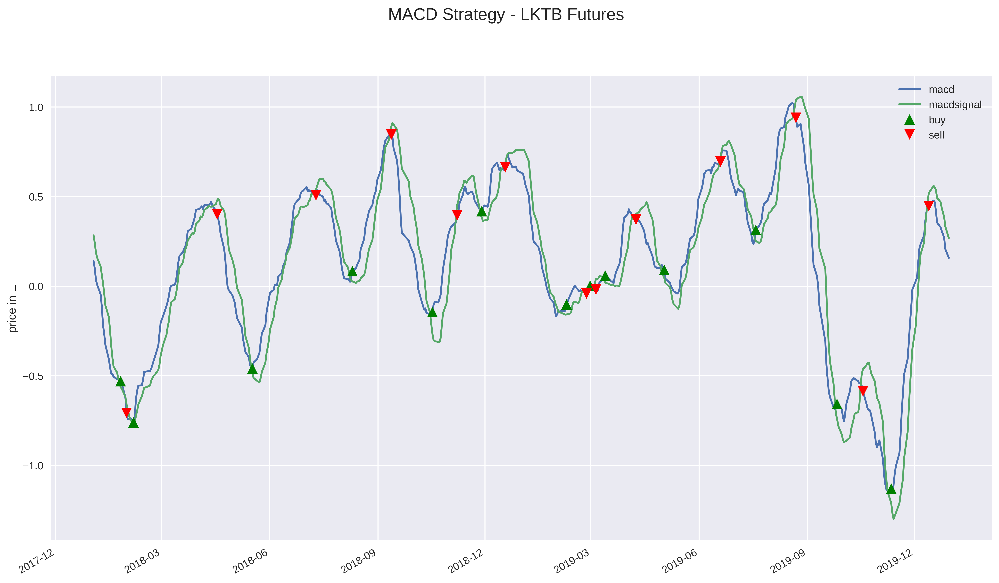

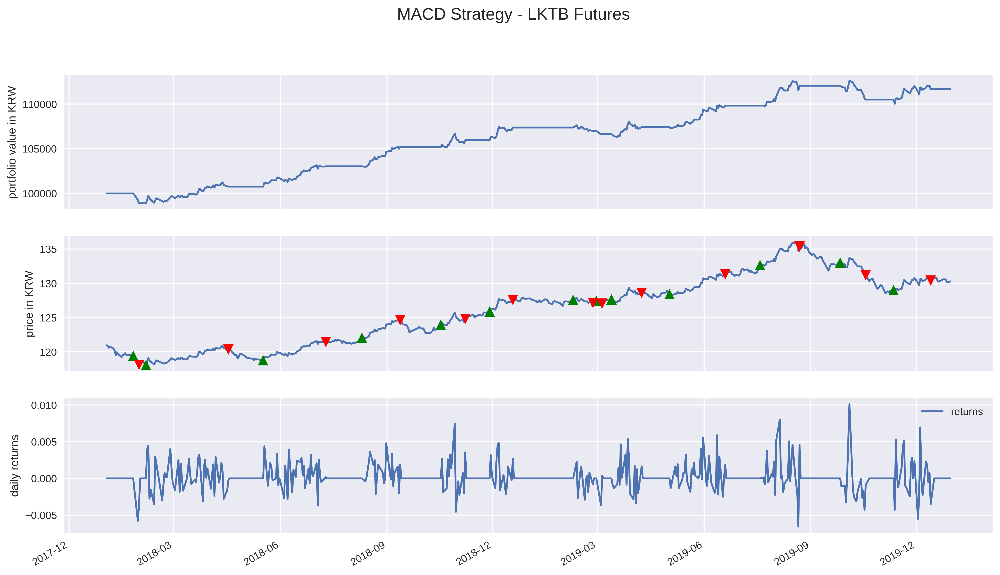

Final portfolio value (including cash): 111664.05KRW


In [13]:
macd_results = pd.read_pickle('macd.pkl')

fig, ax = plt.subplots()

# asset
macd_results[['macd', 'macdsignal']].plot(ax=ax)
ax.set_ylabel('price in ￦')

# mark transactions
perf_trans = macd_results.loc[[t != [] for t in macd_results.transactions]]
buys = perf_trans.loc[[t[0]['amount'] > 0 for t in perf_trans.transactions]]
sells = perf_trans.loc[[t[0]['amount'] < 0 for t in perf_trans.transactions]]
ax.plot(buys.index, macd_results.macd.loc[buys.index], '^', markersize=10, color='g', label='buy')
ax.plot(sells.index, macd_results.macd.loc[sells.index], 'v', markersize=10, color='r', label='sell')
ax.legend()

fig.suptitle('MACD Strategy - LKTB Futures', fontsize=16)
plt.show()

# import helper functions 
import qf_helper_functions as qf

qf.visualize_results(macd_results, 'MACD Strategy - LKTB Futures', 'KRW')
macd_perf = qf.get_performance_summary(macd_results.returns)

Start date,2018-01-02
End date,2019-12-30
Total months,23
,Backtest
Annual return,5.8%
Cumulative returns,11.7%
Annual volatility,2.9%
Sharpe ratio,1.98
Calmar ratio,2.56
Stability,0.96
Max drawdown,-2.3%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,2.28,2019-10-04,2019-11-12,NaT,NaN
1,1.20,2019-02-11,2019-03-18,2019-03-27,33
2,1.10,2018-01-25,2018-01-30,2018-03-15,36
3,1.06,2018-10-29,2018-11-06,2018-12-05,28
4,0.96,2019-08-16,2019-10-01,2019-10-04,36


Stress Events,mean,min,max
New Normal,0.02%,-0.66%,1.01%


Top 10 long positions of all time,max
sid,
LKTB,100.26%


Top 10 short positions of all time,max
sid,


Top 10 positions of all time,max
sid,
LKTB,100.26%


/opt/conda/envs/backtest/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


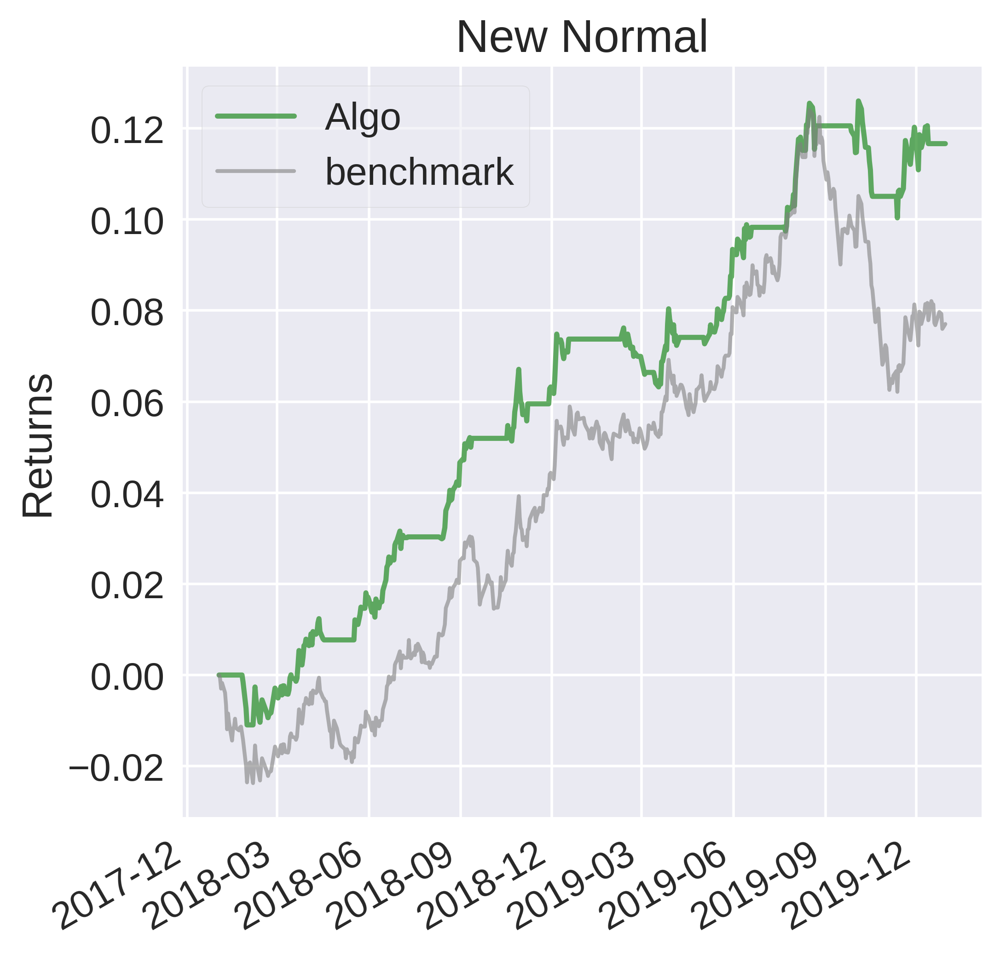

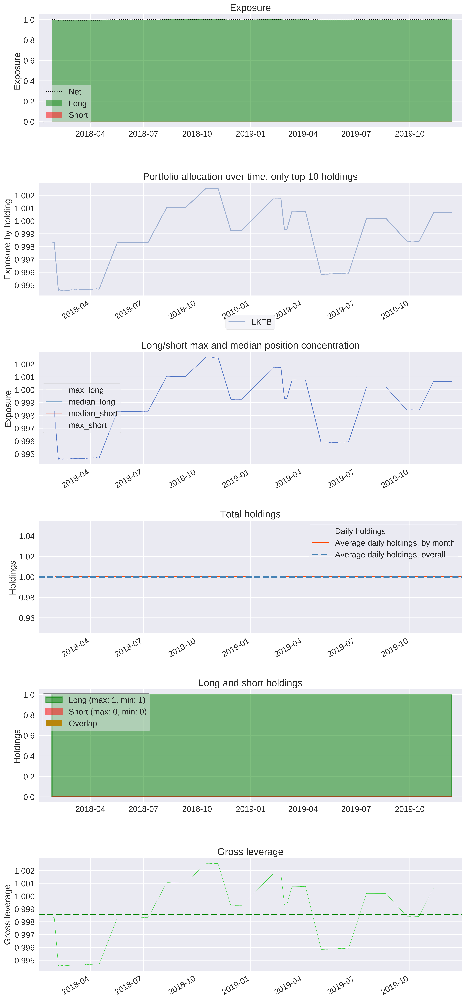

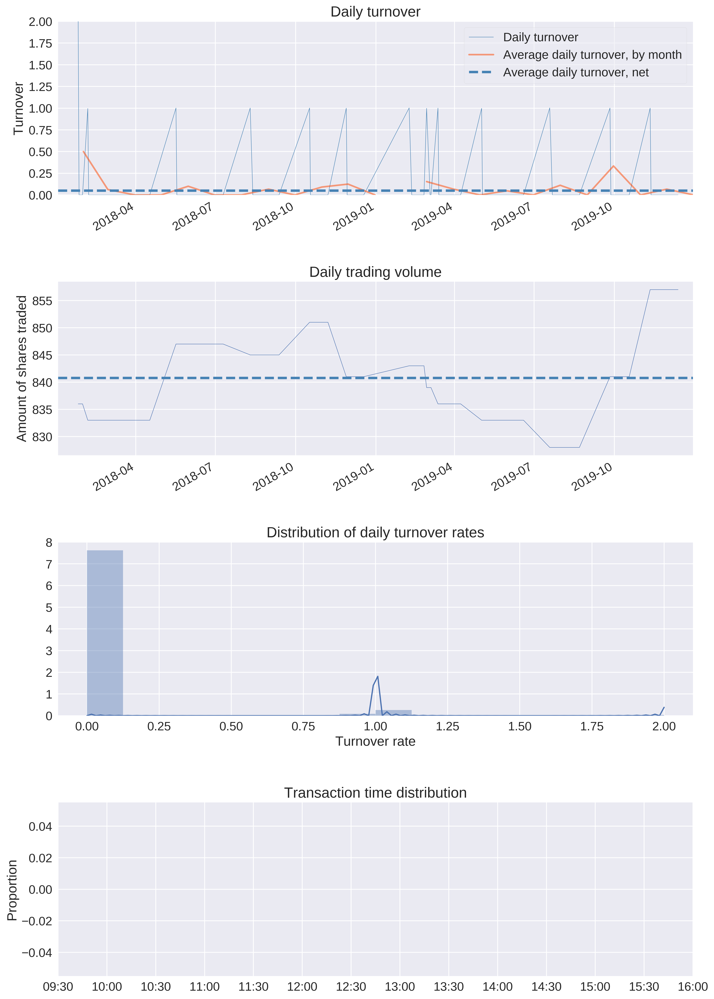

In [14]:
import pyfolio as pf
returns, positions, transactions = pf.utils.extract_rets_pos_txn_from_zipline(macd_results)
benchmark_period_return = macd_results['benchmark_period_return']
# Convert benchmark returns to daily returns
#daily_returns = (1 + benchmark_period_return) / (1 + benchmark_period_return.shift()) - 1
daily_benchmark_returns = np.exp(np.log(benchmark_period_return + 1.0).diff()) - 1
sheets = pf.create_full_tear_sheet(returns, positions=positions, transactions=transactions, benchmark_rets=daily_benchmark_returns)

### 5. RSI

In [15]:
%%zipline --start 2018-1-2 --end 2019-12-30 --capital-base 100000 --bundle krx_futures -o rsi.pkl --trading-calendar XKRX

# imports ----
from zipline.api import order_percent, order, record, symbol, set_benchmark, set_slippage, order_target
from zipline.finance import commission, slippage
import matplotlib.pyplot as plt
import talib as ta

# parameters ----
SELECTED_STOCK = 'LKTB'
UPPER = 70
LOWER = 30
RSI_PERIOD = 14

#initialize the strategy 
def initialize(context):

    set_benchmark(symbol('LKTB'))
    context.asset = symbol(SELECTED_STOCK)
    context.has_position = False
    context.set_commission(commission.PerShare(cost=0.0, min_trade_cost=0))
    context.set_slippage(slippage.FixedSlippage(spread=0))
    
def handle_data(context, data):
    
    price_history = data.history(context.asset, fields="price", bar_count=RSI_PERIOD+1, frequency="1d")
    rsi = ta.RSI(price_history, timeperiod=RSI_PERIOD)
    
    if rsi[-1] < LOWER and not context.has_position:
        order_percent(context.asset, 1.0)
        context.has_position = True
      
    if rsi[-1] > UPPER and context.has_position:
        order_target(context.asset, 0)
        context.has_position = False
     
    record(rsi=rsi[-1], price=price_history[-1]) 

/opt/conda/envs/backtest/lib/python3.5/site-packages/empyrical/stats.py:704: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/opt/conda/envs/backtest/lib/python3.5/site-packages/empyrical/stats.py:790: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)


,algo_volatility,algorithm_period_return,alpha,benchmark_period_return,benchmark_volatility,beta,capital_used,ending_cash,ending_exposure,ending_value,...,short_exposure,short_value,shorts_count,sortino,starting_cash,starting_exposure,starting_value,trading_days,transactions,treasury_period_return
2018-01-02 06:30:00+00:00,NaN,0.000000,NaN,-0.002474,NaN,NaN,0.00,100000.00,0.000,0.000,...,0.0,0.0,0,NaN,100000.00,0.000,0.000,1,[],0.0
2018-01-03 06:30:00+00:00,0.000000,0.000000,0.000000,-0.003216,0.019419,0.000000,0.00,100000.00,0.000,0.000,...,0.0,0.0,0,NaN,100000.00,0.000,0.000,2,[],0.0
2018-01-04 06:30:00+00:00,0.000000,0.000000,0.000000,-0.005443,0.014877,0.000000,0.00,100000.00,0.000,0.000,...,0.0,0.0,0,NaN,100000.00,0.000,0.000,3,[],0.0
2018-01-05 06:30:00+00:00,0.000000,0.000000,0.000000,-0.004206,0.027164,0.000000,-100101.75,-101.75,100101.750,100101.750,...,0.0,0.0,0,NaN,100000.00,0.000,0.000,4,"[{'sid': Equity(5 [LKTB]), 'commission': None,...",0.0
2018-01-08 06:30:00+00:00,0.015302,-0.002155,-0.046222,-0.006350,0.024790,0.194662,0.00,-101.75,99886.210,99886.210,...,0.0,0.0,0,-7.099296,-101.75,100101.750,100101.750,5,[],0.0
2018-01-09 06:30:00+00:00,0.020286,-0.004891,-0.049353,-0.009071,0.024124,0.408998,0.00,-101.75,99612.640,99612.640,...,0.0,0.0,0,-9.100181,-101.75,99886.210,99886.210,6,[],0.0
2018-01-10 06:30:00+00:00,0.032817,-0.010197,0.053272,-0.014349,0.031740,0.811603,0.00,-101.75,99082.080,99082.080,...,0.0,0.0,0,-9.633125,-101.75,99612.640,99612.640,7,[],0.0
2018-01-11 06:30:00+00:00,0.041279,-0.006715,0.082463,-0.010886,0.042925,0.854898,0.00,-101.75,99430.260,99430.260,...,0.0,0.0,0,-5.912073,-101.75,99082.080,99082.080,8,[],0.0
2018-01-12 06:30:00+00:00,0.039174,-0.008787,0.067623,-0.012947,0.040333,0.862732,0.00,-101.75,99223.010,99223.010,...,0.0,0.0,0,-6.944024,-101.75,99430.260,99430.260,9,[],0.0
2018-01-15 06:30:00+00:00,0.039798,-0.012684,0.060696,-0.016823,0.040017,0.894434,0.00,-101.75,98833.380,98833.380,...,0.0,0.0,0,-8.221976,-101.75,99223.010,99223.010,10,[],0.0


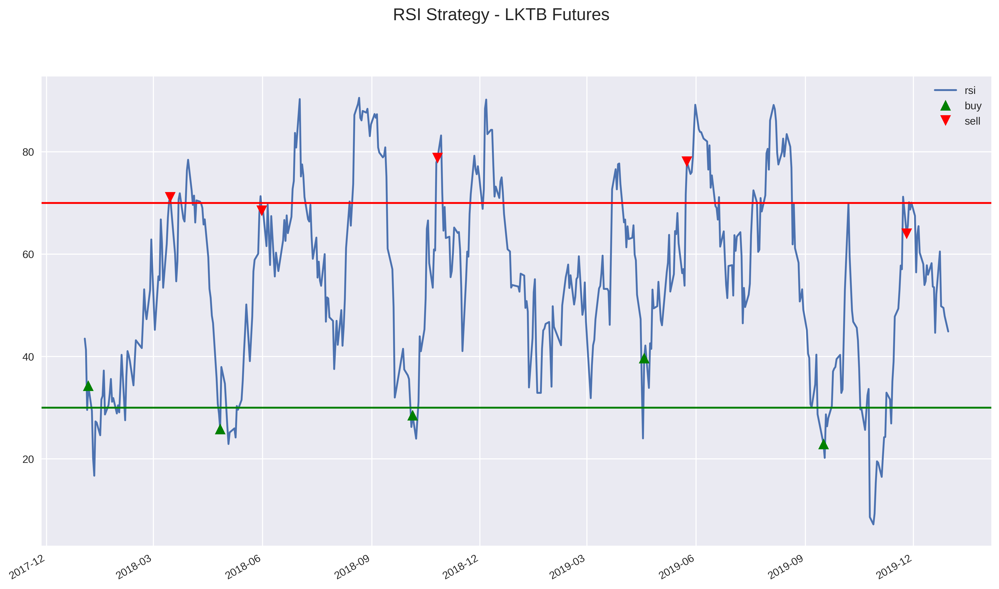

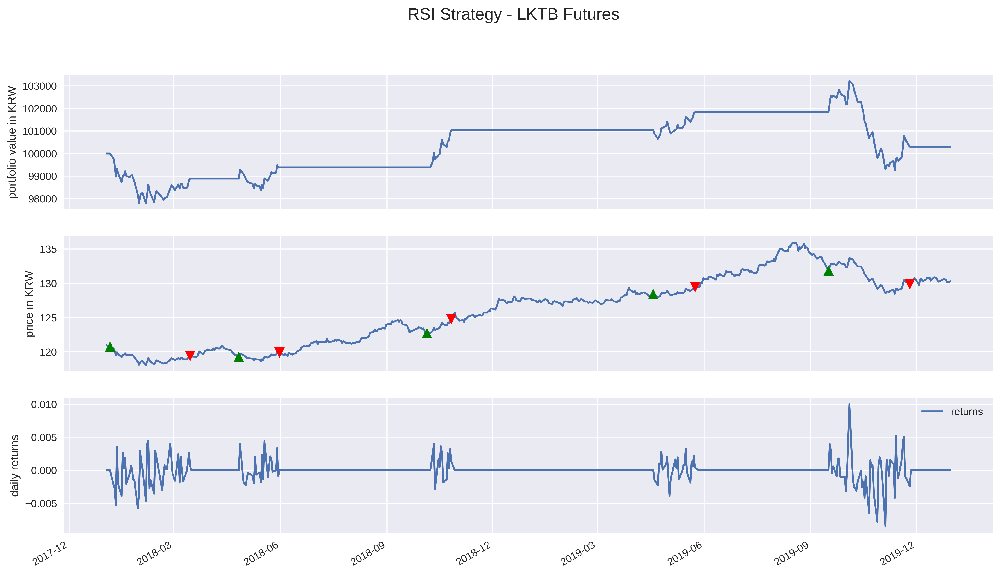

Final portfolio value (including cash): 100302.37KRW


In [16]:
rsi_results = pd.read_pickle('rsi.pkl')

#fig, ax = plt.subplots(1, 1, sharex=True, figsize=[16, 9])
fig, ax = plt.subplots()

# asset
rsi_results[['rsi']].plot(ax=ax)
ax.axhline(y=70, color='r')
ax.axhline(y=30, color='g')

# mark transactions
perf_trans = rsi_results.loc[[t != [] for t in rsi_results.transactions]]
buys = perf_trans.loc[[t[0]['amount'] > 0 for t in perf_trans.transactions]]
sells = perf_trans.loc[[t[0]['amount'] < 0 for t in perf_trans.transactions]]
ax.plot(buys.index, rsi_results.rsi.loc[buys.index], '^', markersize=10, color='g', label='buy')
ax.plot(sells.index, rsi_results.rsi.loc[sells.index], 'v', markersize=10, color='r', label='sell')
ax.legend()

fig.suptitle('RSI Strategy - LKTB Futures', fontsize=16)
plt.show()

# import helper functions 
import qf_helper_functions as qf

qf.visualize_results(rsi_results, 'RSI Strategy - LKTB Futures', 'KRW')
rsi_perf = qf.get_performance_summary(rsi_results.returns)

Start date,2018-01-02
End date,2019-12-30
Total months,23
,Backtest
Annual return,0.2%
Cumulative returns,0.3%
Annual volatility,2.3%
Sharpe ratio,0.08
Calmar ratio,0.04
Stability,0.60
Max drawdown,-3.8%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,3.84,2019-10-04,2019-11-12,NaT,NaN
1,2.21,2018-01-05,2018-02-05,2018-10-11,200
2,0.62,2019-09-25,2019-10-01,2019-10-04,8
3,0.53,2019-04-30,2019-05-03,2019-05-16,13
4,0.37,2019-04-18,2019-04-22,2019-04-25,6


Stress Events,mean,min,max
New Normal,0.00%,-0.85%,1.00%


Top 10 long positions of all time,max
sid,
LKTB,100.42%


Top 10 short positions of all time,max
sid,


Top 10 positions of all time,max
sid,
LKTB,100.42%


/opt/conda/envs/backtest/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


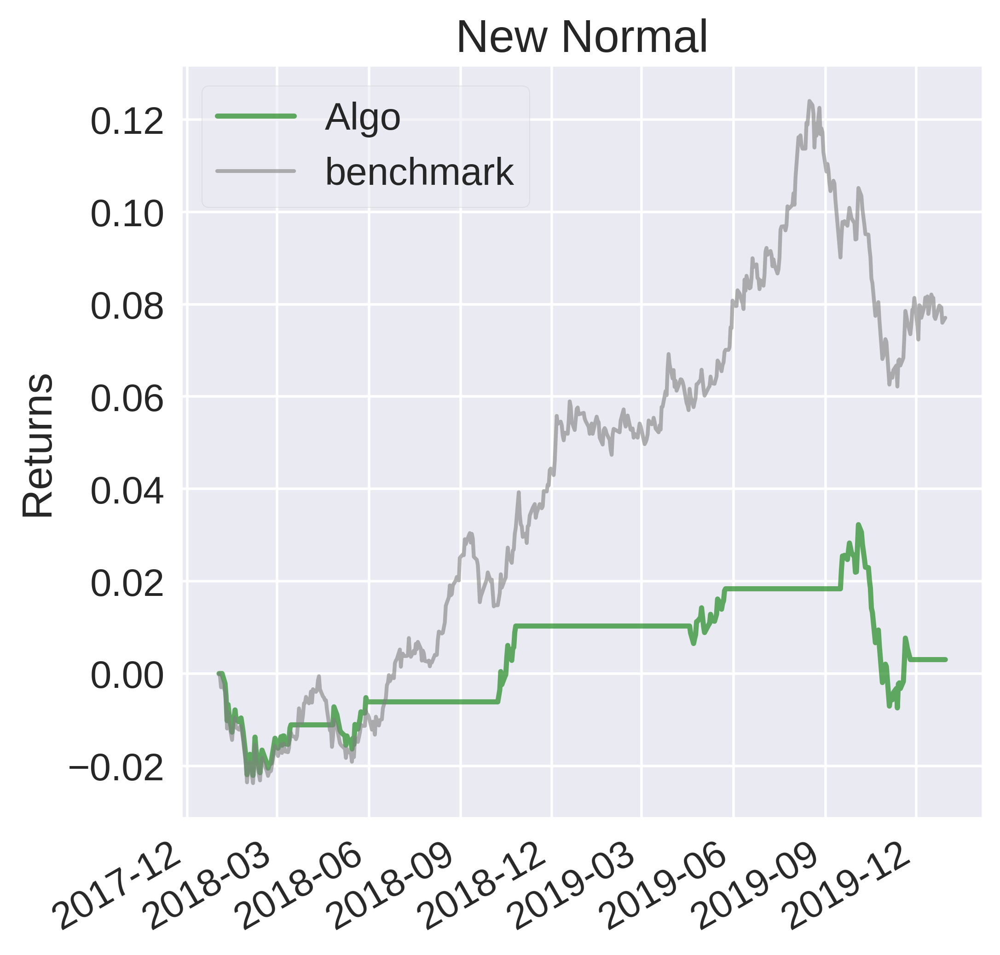

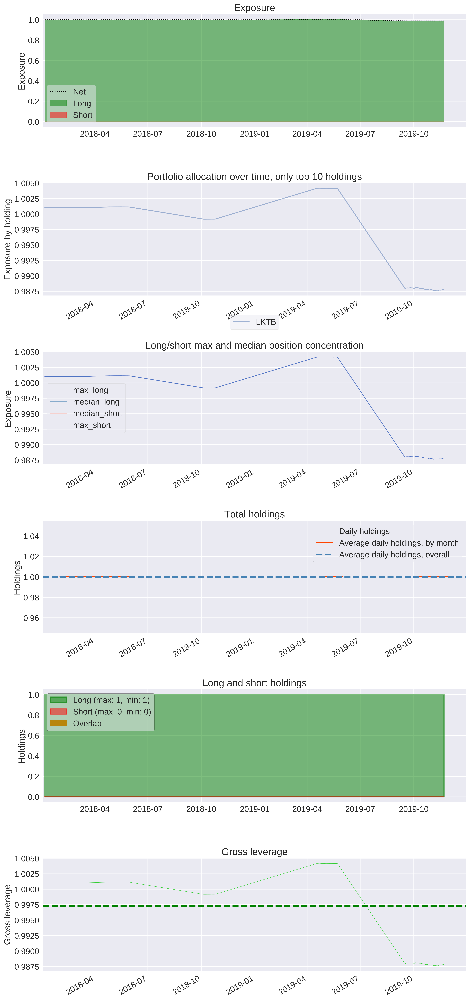

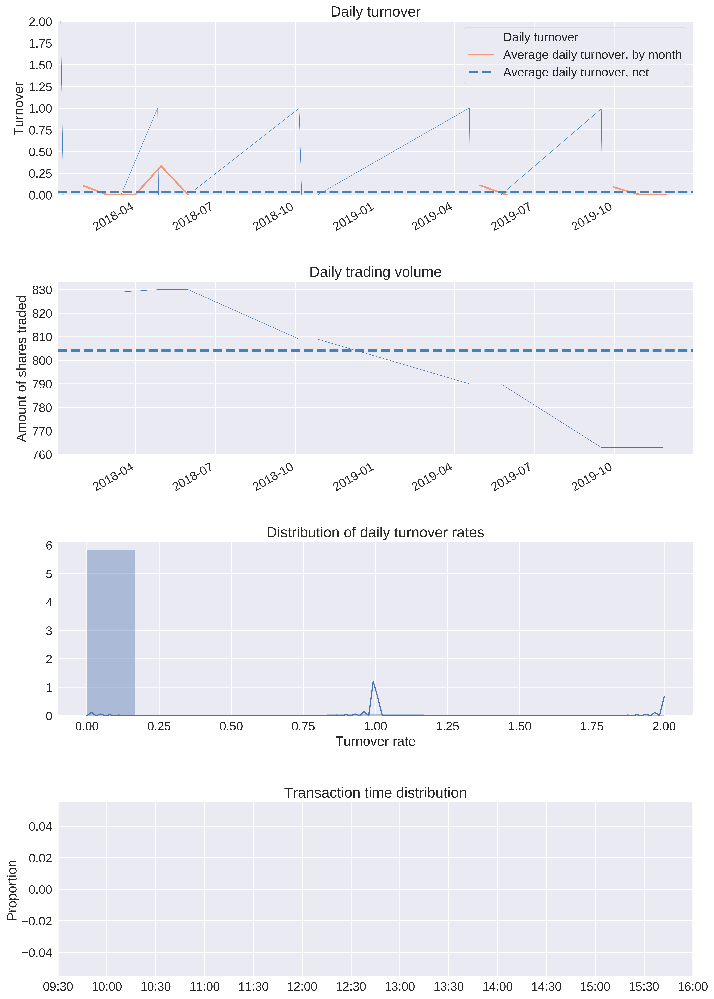

In [17]:
import pyfolio as pf
returns, positions, transactions = pf.utils.extract_rets_pos_txn_from_zipline(rsi_results)
benchmark_period_return = rsi_results['benchmark_period_return']
# Convert benchmark returns to daily returns
#daily_returns = (1 + benchmark_period_return) / (1 + benchmark_period_return.shift()) - 1
daily_benchmark_returns = np.exp(np.log(benchmark_period_return + 1.0).diff()) - 1
sheets = pf.create_full_tear_sheet(returns, positions=positions, transactions=transactions, benchmark_rets=daily_benchmark_returns)

---

## Evaluating the performance

In [18]:
perf_df = pd.DataFrame({'1.Buy and Hold': buy_and_hold_perf,
                        '2.Simple Moving Average': sma_perf,
                        '3.Moving Average Crossover': mac_perf,
                        '4.MACD': macd_perf,
                        '5.RSI': rsi_perf})
perf_df.transpose()

,annual_volatility,annualized_returns,cumulative_returns,max_drawdown,sharpe_ratio,sortino_ratio
1.Buy and Hold,0.039062,0.038999,0.077227,-0.054969,0.998988,1.489036
2.Simple Moving Average,0.028612,0.046163,0.091716,-0.026710,1.591682,2.638060
3.Moving Average Crossover,0.032513,0.036532,0.072259,-0.041326,1.119865,1.746226
4.MACD,0.028873,0.058379,0.116640,-0.022791,1.979731,3.512836
5.RSI,0.023107,0.001554,0.003024,-0.038444,0.078728,0.110524


MACD 전략이 연환산 수익율 5.8%, 최대 drawdown -2.2% 및 샤프지수 등으로 종합 우수함.